Clustering for single cell RNA Sequencing Analysis for SKG mice Rheumatoid Arthritis Project


Last Updated on: August 10, 2021

In [2]:
import sys

#Import libraries
import time
import numpy as np
import pandas as pd
#import scanpy.api as sc
import scanpy as sc
import anndata as ad
from scipy.sparse import csr_matrix
import logging
#from skbio.stats.composition import clr

#import doubletdetection
import matplotlib.pyplot as plt
import matplotlib.axes as axes
import os
import copy


sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)


sc.logging.print_versions() 
sc.settings.set_figure_params(dpi=100)



/wynton/home/ye/emccarthy/miniconda3/envs/scanpy/lib/python3.7/site-packages/anndata/_core/anndata.py:21: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex


scanpy==1.4.6 anndata==0.7.1 umap==0.3.10 numpy==1.18.1 scipy==1.4.1 pandas==1.0.1 scikit-learn==0.22.1 statsmodels==0.11.0 python-igraph==0.7.1 louvain==0.6.1


In [2]:
sample_list = pd.read_csv('data/sc_RNA_sample_sheet.csv', sep = ',')
sample_list['sample_names'] = [str(x) + '_' + y + '_' + z for x,y,z in zip(sample_list['mouse'],sample_list['genotype'],sample_list['GFP'])]
no_wells = sample_list.shape[0]
RNA_adata = [None]* no_wells


sample_names = np.array(sample_list['sample_names'])
path = #fill in directory location with saved adata objects
adata_files = [path + x + '.h5ad' for x in sample_names]
for index in range(len(adata_files)):
    RNA_adata[index] = sc.read(adata_files[index])


In [3]:
RNA_adata

[AnnData object with n_obs × n_vars = 12166 × 31054 
     obs: 'mouse', 'genotype', 'GFP', 'platelet', 'RBC', 'percent_mito', 'n_counts', 'n_genes'
     var: 'gene_ids', 'feature_types',
 AnnData object with n_obs × n_vars = 11577 × 31054 
     obs: 'mouse', 'genotype', 'GFP', 'platelet', 'RBC', 'percent_mito', 'n_counts', 'n_genes'
     var: 'gene_ids', 'feature_types',
 AnnData object with n_obs × n_vars = 14290 × 31054 
     obs: 'mouse', 'genotype', 'GFP', 'platelet', 'RBC', 'percent_mito', 'n_counts', 'n_genes'
     var: 'gene_ids', 'feature_types',
 AnnData object with n_obs × n_vars = 12870 × 31054 
     obs: 'mouse', 'genotype', 'GFP', 'platelet', 'RBC', 'percent_mito', 'n_counts', 'n_genes'
     var: 'gene_ids', 'feature_types',
 AnnData object with n_obs × n_vars = 12320 × 31054 
     obs: 'mouse', 'genotype', 'GFP', 'platelet', 'RBC', 'percent_mito', 'n_counts', 'n_genes'
     var: 'gene_ids', 'feature_types',
 AnnData object with n_obs × n_vars = 13188 × 31054 
     obs: 'm

In [4]:
len(RNA_adata)

8

In [7]:
adata = RNA_adata[0].concatenate(RNA_adata[1],RNA_adata[2],RNA_adata[3],RNA_adata[4],RNA_adata[5],RNA_adata[6],RNA_adata[7])
adata

AnnData object with n_obs × n_vars = 101869 × 31054 
    obs: 'GFP', 'RBC', 'batch', 'genotype', 'mouse', 'n_counts', 'n_genes', 'percent_mito', 'platelet'
    var: 'gene_ids', 'feature_types'

In [3]:
non_T_barcodes = np.load('data/non_T_barcodes.npy', allow_pickle = True )

In [4]:
len(non_T_barcodes)

1008

In [9]:

percent_mito_cutoff = .10
max_genes_cutoff = 3000

#Filter cells by cells with min_genes > 100 and genes that appear in at least 3 cells
sc.pp.filter_cells(adata, min_genes=100)
sc.pp.filter_genes(adata, min_cells=3)
before_mito = adata.X.shape[0]
    
#Filter cells by cells with % mito
adata = adata[adata.obs['percent_mito'] < percent_mito_cutoff, :]
print("Dead cells removed: ", before_mito - adata.X.shape[0])
adata = adata[adata.obs['RBC'] == False]

#Remove B cells
adata = adata[[x not in non_T_barcodes for x in adata.obs.index]]

# Filter cells with abnormally high gene counts.
sc.pp.filter_cells(adata, max_genes=max_genes_cutoff)
adata.uns['barcodes'] = adata.obs_names.tolist().copy()
adata.uns['genes'] = adata.var_names.tolist().copy()
mat=adata.X
adata.uns['raw_counts'] = mat.copy()
#Normalize gene counts

sc.pp.normalize_total(adata, target_sum=1e4)
    
#Log transform the data
sc.pp.log1p(adata)
#Store raw data
adata.raw = adata

filtered out 1 cells that have less than 100 genes expressed
filtered out 14388 genes that are detected in less than 3 cells
Dead cells removed:  1066


Trying to set attribute `.obs` of view, making a copy.


filtered out 720 cells that have more than  3000 genes expressed


In [10]:

path = 'adata_object/'
adata_file = path + 'adata_only_T_cells.h5ad'
adata.write(adata_file,compression="gzip")

... storing 'GFP' as categorical
... storing 'genotype' as categorical
... storing 'feature_types' as categorical
... storing 'feature_types' as categorical


In [11]:
del adata
adata = sc.read(adata_file)


Trying to set attribute `.var` of view, making a copy.


--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


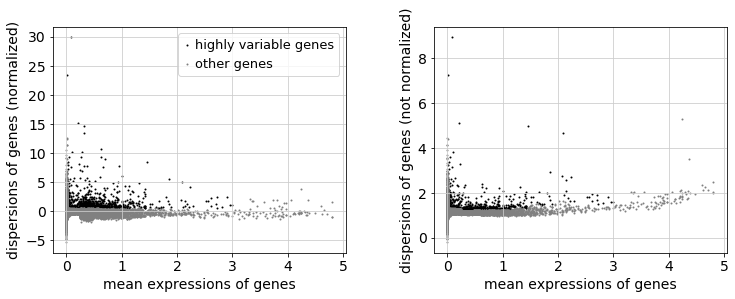

In [12]:
## Extract TCR gene names and remove from adata dataset
genes = adata.var_names
non_tcr = []
for gene in genes:
    if gene[0:4] not in ['Trav','Trbv']:
        non_tcr.append(gene)
adata = adata[:, non_tcr]

sc.pp.highly_variable_genes(adata)
sc.pl.highly_variable_genes(adata)
#Filter to highly variable genes
#variable_genes = adata.var['highly_variable'].index[np.where(adata.var['highly_variable'] == True)]
adata = adata[:, adata.var['highly_variable']]

In [13]:
sc.pp.regress_out(adata, ['n_counts', 'percent_mito'])

regressing out ['n_counts', 'percent_mito']
    sparse input is densified and may lead to high memory use
    finished (0:01:24.85)


In [14]:
sc.pp.combat(adata, key='batch', covariates=None, inplace=True)

Standardizing Data across genes.

Found 8 batches

Found 0 numerical variables:
	

Fitting L/S model and finding priors

Finding parametric adjustments



/netapp/home/jashouri1/miniconda3/envs/scanpy_v1-4-3/lib/python3.7/site-packages/scanpy/preprocessing/_combat.py:269: NumbaWarning: 
Compilation is falling back to object mode WITH looplifting enabled because Function "_it_sol" failed type inference due to: Cannot unify array(float64, 2d, C) and array(float64, 1d, C) for 'sum2', defined at /netapp/home/jashouri1/miniconda3/envs/scanpy_v1-4-3/lib/python3.7/site-packages/scanpy/preprocessing/_combat.py (311)

File "../../../../../../../netapp/home/jashouri1/miniconda3/envs/scanpy_v1-4-3/lib/python3.7/site-packages/scanpy/preprocessing/_combat.py", line 311:
def _it_sol(s_data, g_hat, d_hat, g_bar, t2, a, b, conv=0.0001) -> Tuple[float, float]:
    <source elided>
        g_new = (t2*n*g_hat + d_old*g_bar) / (t2*n + d_old)
        sum2 = s_data - g_new.reshape((g_new.shape[0], 1)) @ np.ones((1, s_data.shape[1]))
        ^

[1] During: typing of assignment at /netapp/home/jashouri1/miniconda3/envs/scanpy_v1-4-3/lib/python3.7/site-packages/

Adjusting data



In [15]:
sc.pp.scale(adata, max_value=10)

computing PCA with n_comps = 50
computing PCA on highly variable genes
    finished (0:02:31.18)


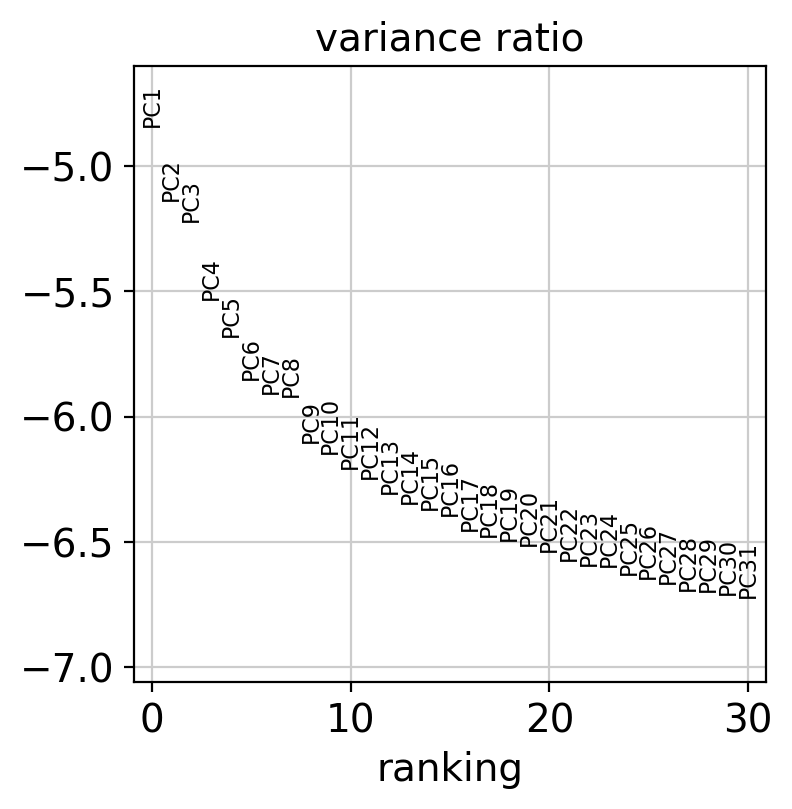

In [16]:
%matplotlib inline
sc.settings.set_figure_params(dpi=100)
# Set parameters
intialization = 1

# Run louvain clustering on theoretical future gene expression per cell
sc.pp.pca(adata, random_state=intialization, svd_solver='arpack')
sc.pl.pca_variance_ratio(adata, log=True )

In [17]:
intialization = 1
#n_components = 25
#resolution = 3

sc.pp.neighbors(adata, random_state=intialization)
sc.tl.louvain(adata, random_state=30)
sc.tl.leiden(adata, random_state=30)
sc.tl.umap(adata, random_state=intialization)

computing neighbors
    using 'X_pca' with n_pcs = 50


/netapp/home/jashouri1/miniconda3/envs/scanpy_v1-4-3/lib/python3.7/site-packages/numba/typed_passes.py:271: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/latest/user/parallel.html#diagnostics for help.

File "../../../../../../../netapp/home/jashouri1/miniconda3/envs/scanpy_v1-4-3/lib/python3.7/site-packages/umap/rp_tree.py", line 135:
@numba.njit(fastmath=True, nogil=True, parallel=True)
def euclidean_random_projection_split(data, indices, rng_state):
^

  state.func_ir.loc))
/netapp/home/jashouri1/miniconda3/envs/scanpy_v1-4-3/lib/python3.7/site-packages/umap/nndescent.py:92: NumbaPerformanceWarning: 
The keyword argument 'parallel=True' was specified but no transformation for parallel execution was possible.

To find out why, try turning on parallel diagnostics, see http://numba.pydata.org/numba-doc/lat

    finished (0:00:49.22) --> added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:36.35) --> found 12 clusters and added
    'louvain', the cluster labels (adata.obs, categorical)
running Leiden clustering
    finished (0:04:50.46) --> found 13 clusters and added
    'leiden', the cluster labels (adata.obs, categorical)
computing UMAP
    using 'X_pca' with n_pcs = 50
    finished (0:02:48.27) --> added
    'X_umap', UMAP coordinates (adata.obsm)


In [19]:
adata.obs['GFP_category'] = ['High' in x for x in np.array(adata.obs['GFP'])]

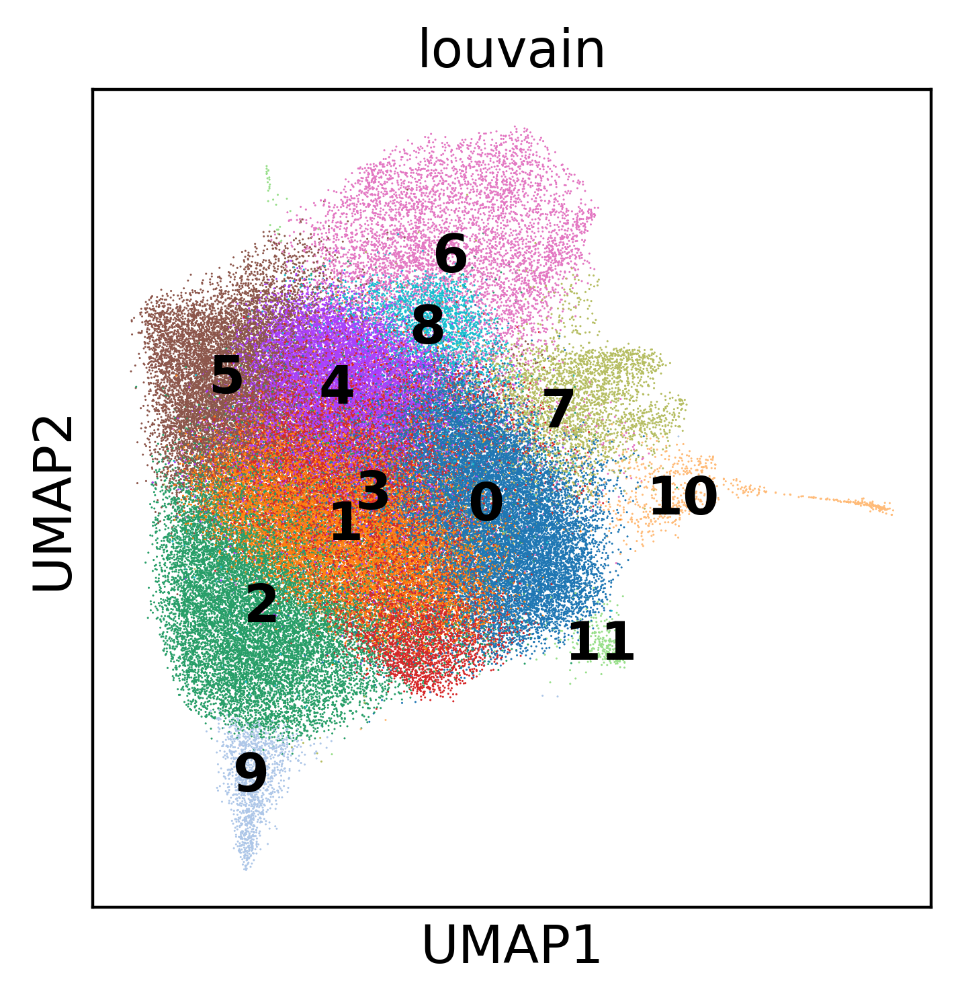

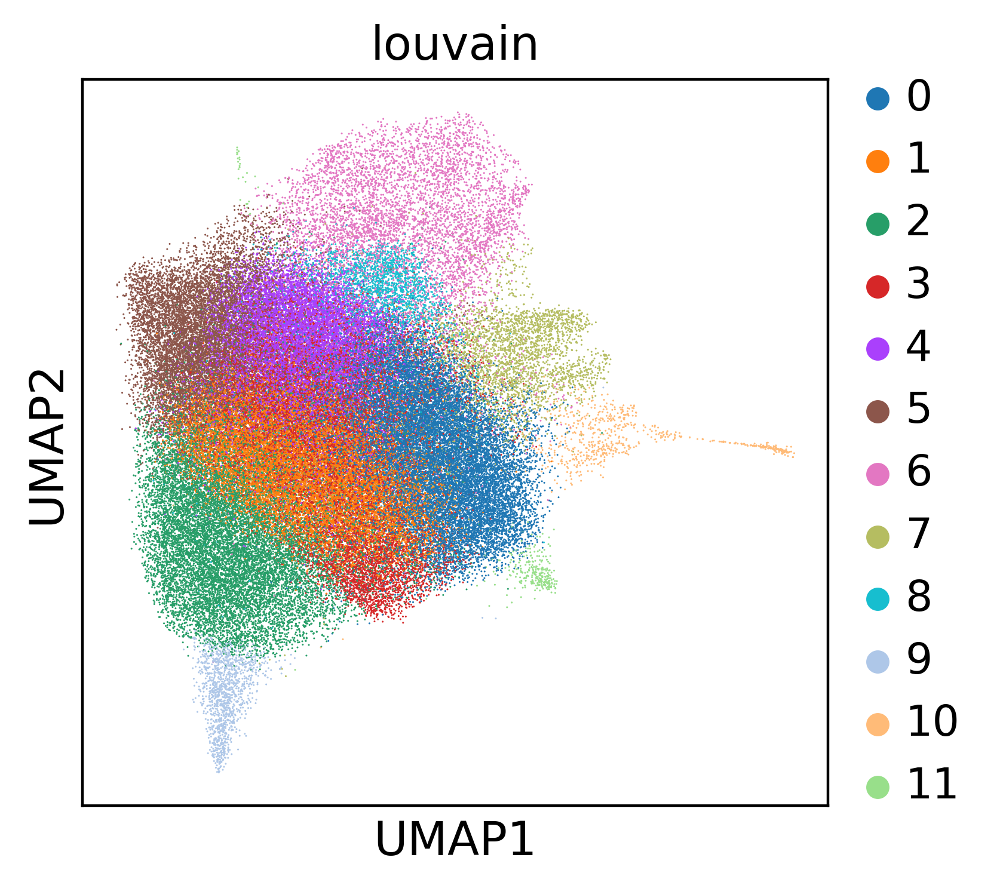

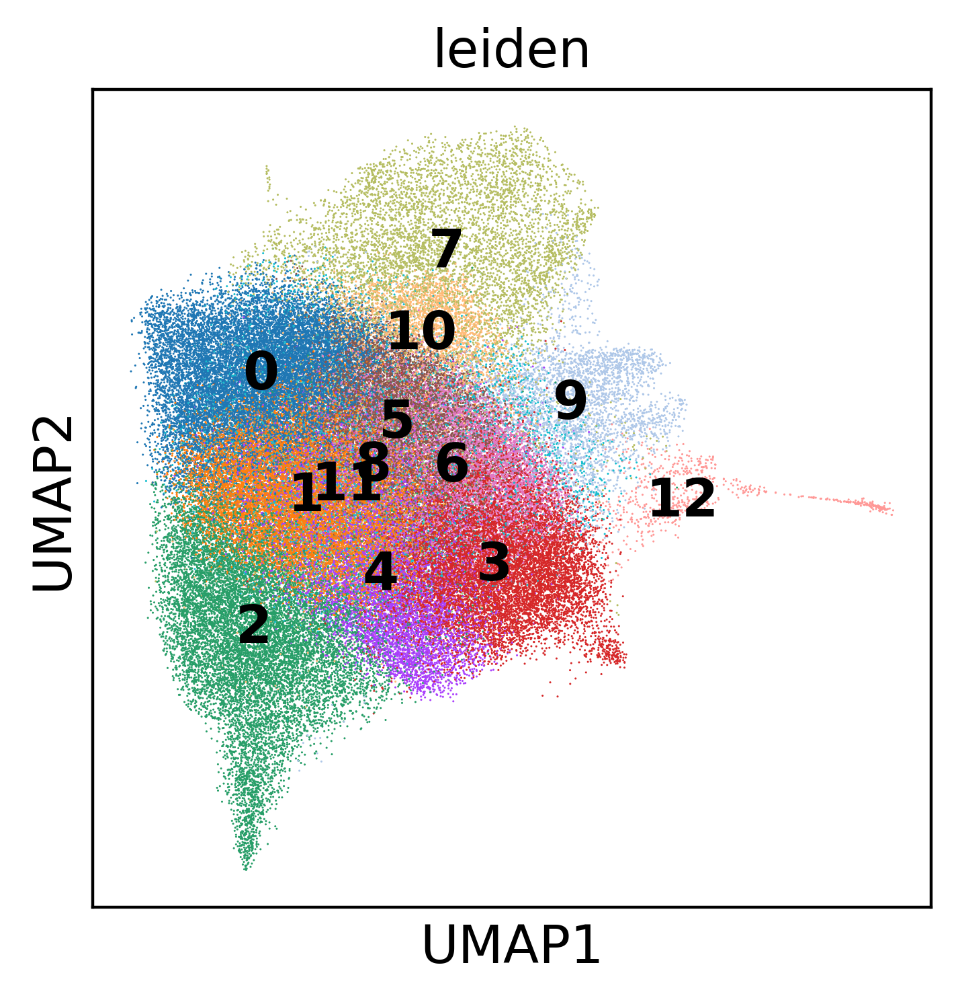

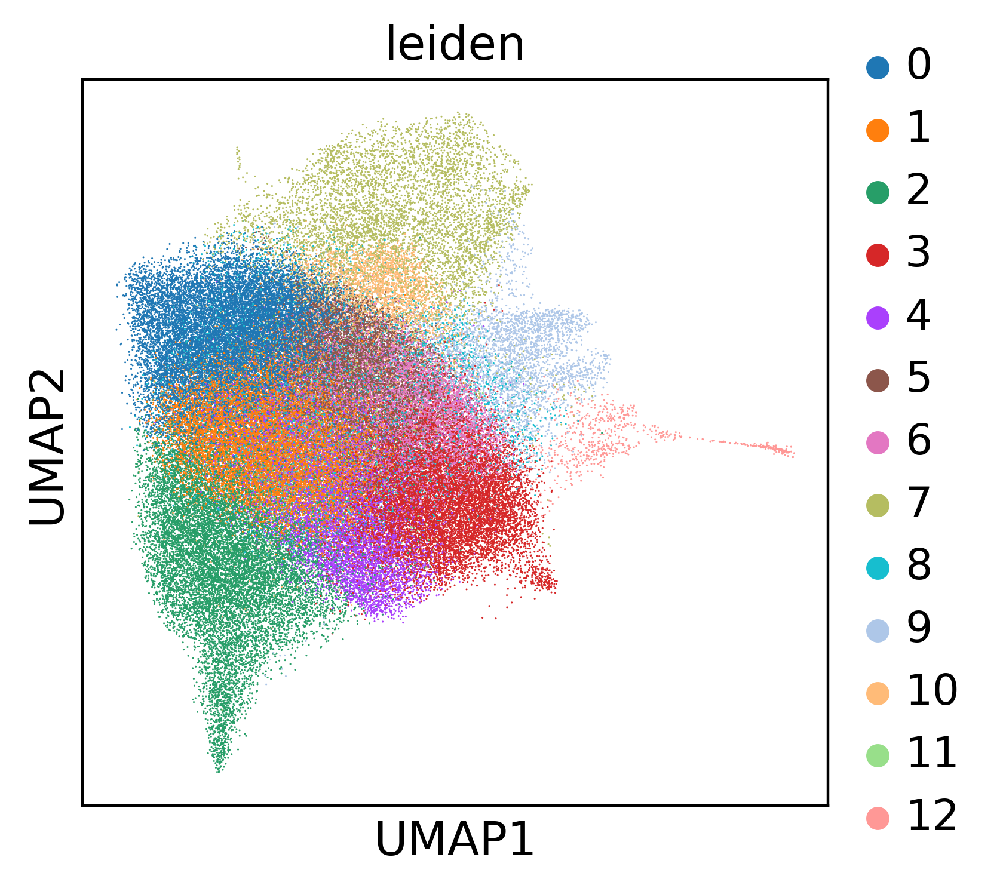

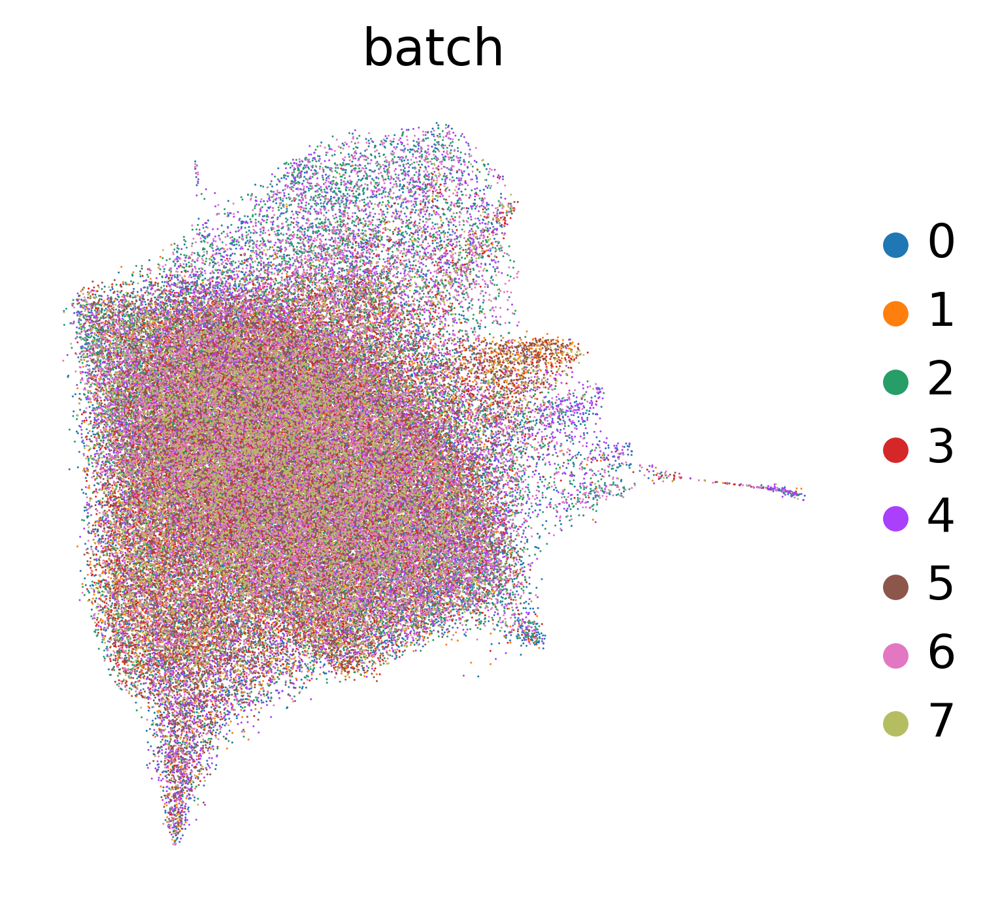

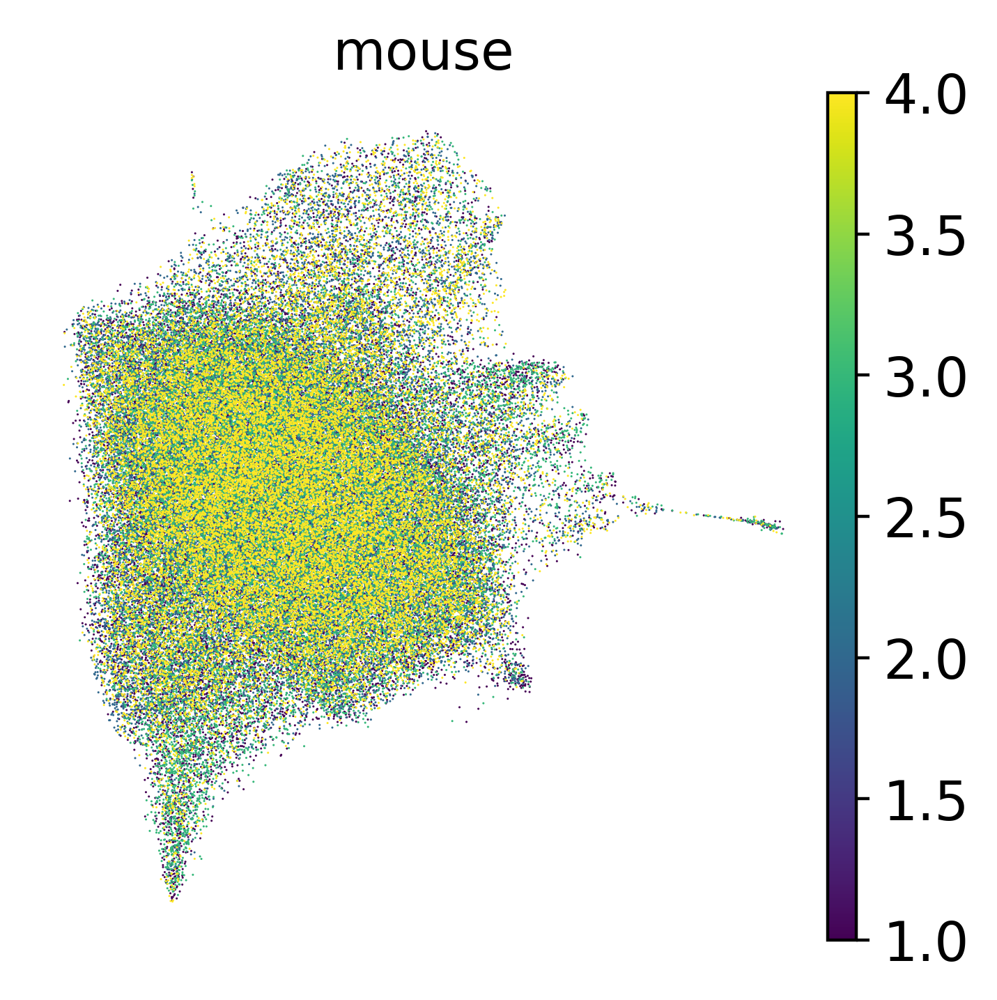

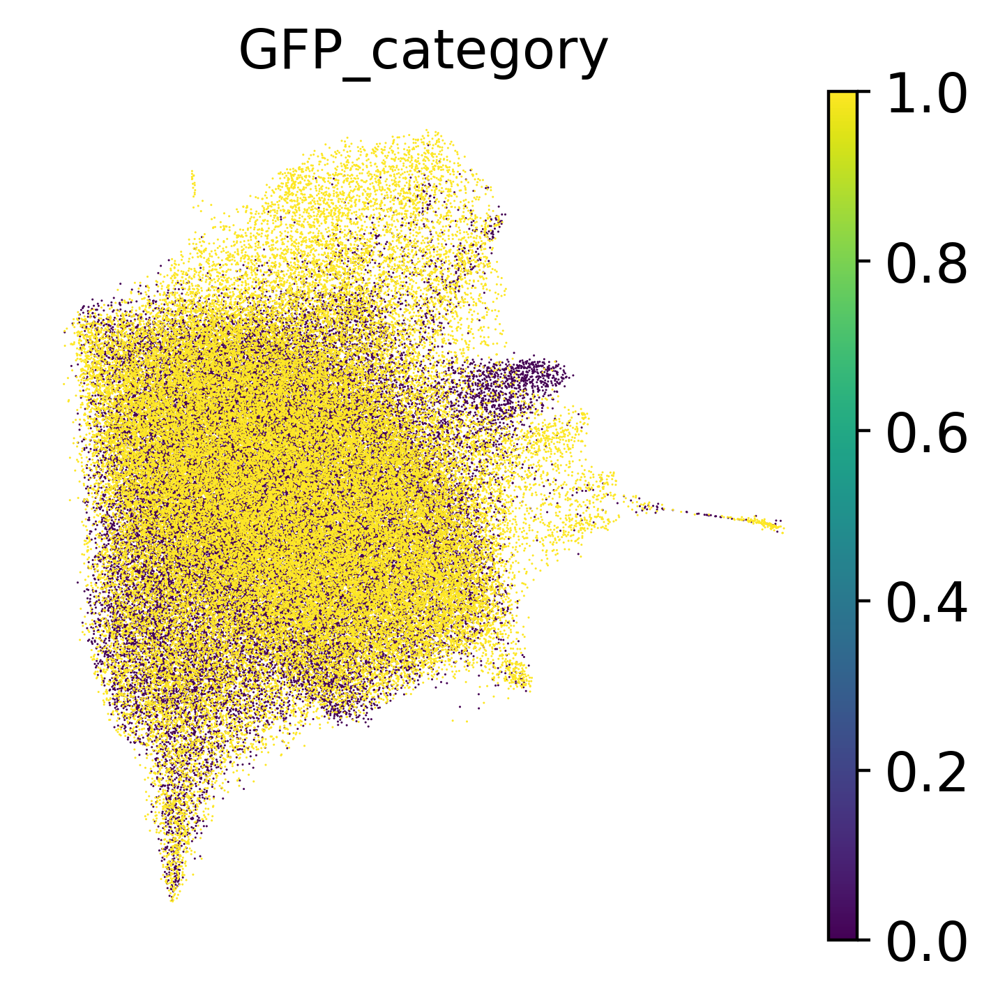

In [20]:
%matplotlib inline
sc.settings.set_figure_params(dpi=200)
sc.pl.umap(adata, color=['louvain'],legend_loc = 'on data')
sc.pl.umap(adata, color=['louvain'])
sc.pl.umap(adata, color=['leiden'],legend_loc = 'on data')
sc.pl.umap(adata, color=['leiden'])
sc.pl.umap(adata, color=['batch'], frameon=False)
sc.pl.umap(adata, color=['mouse'], frameon=False)
sc.pl.umap(adata, color=['GFP_category'], frameon=False)


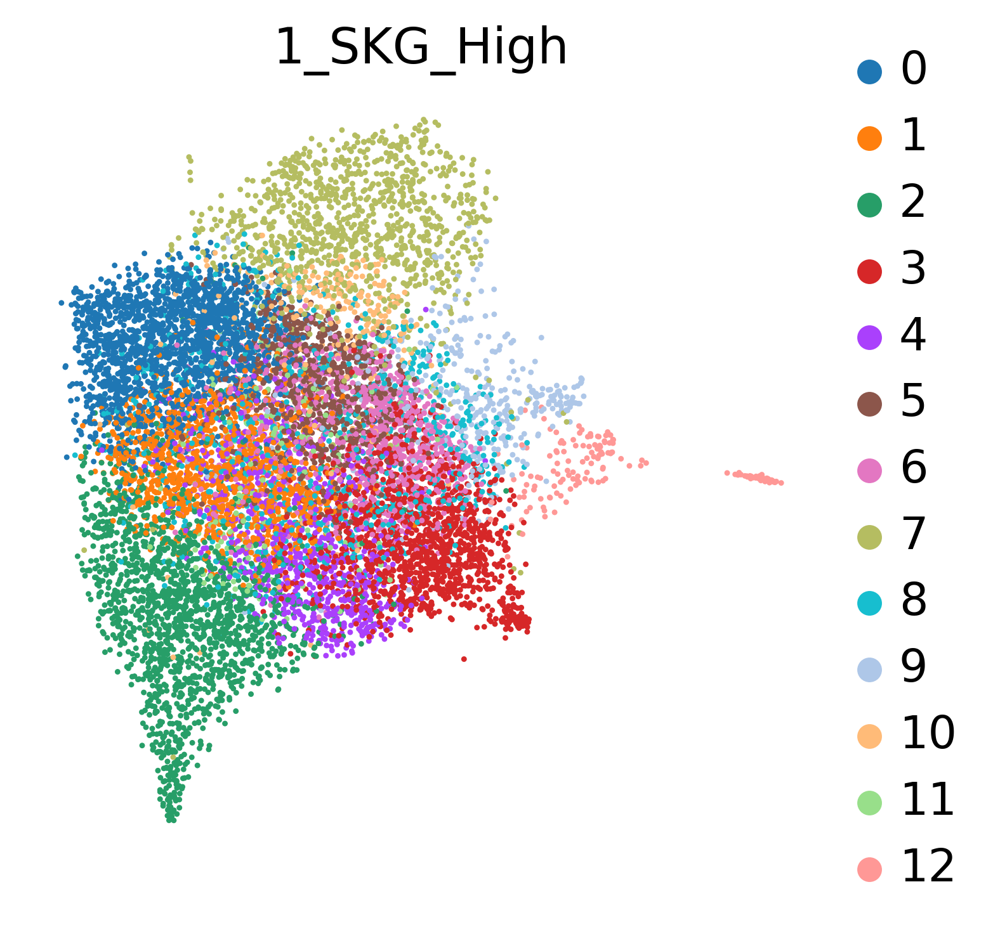

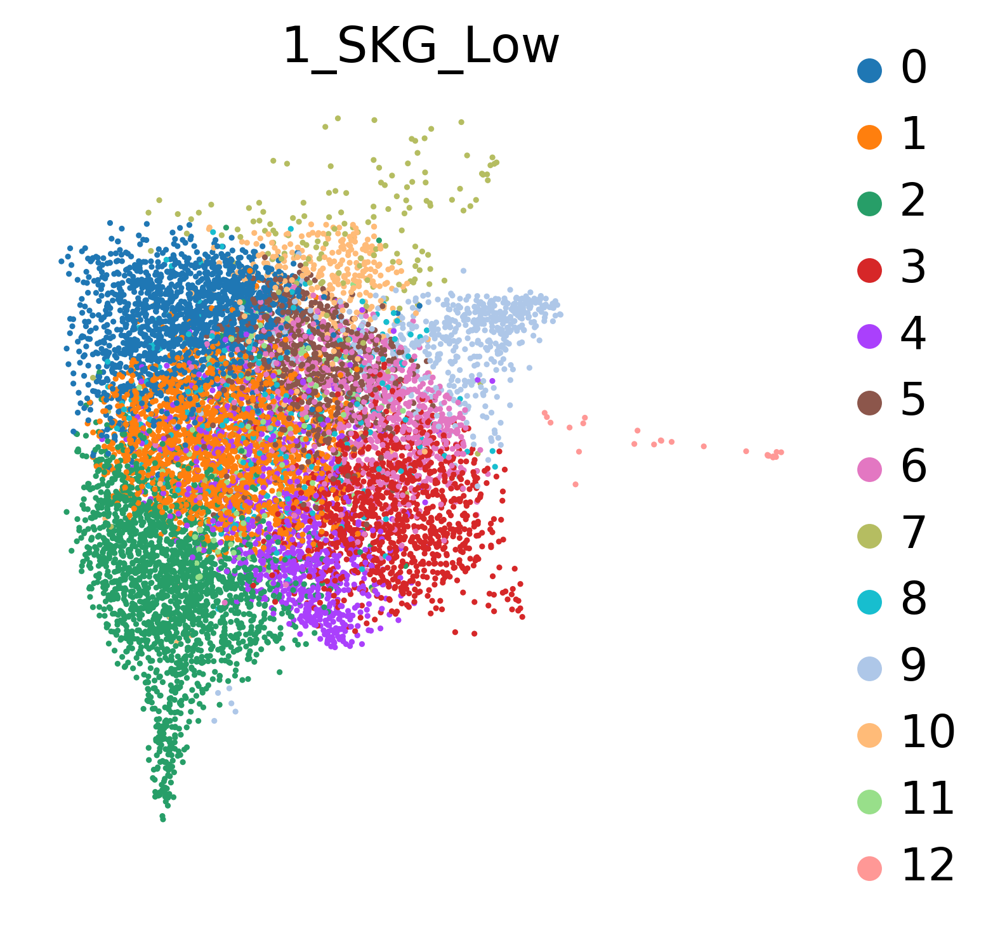

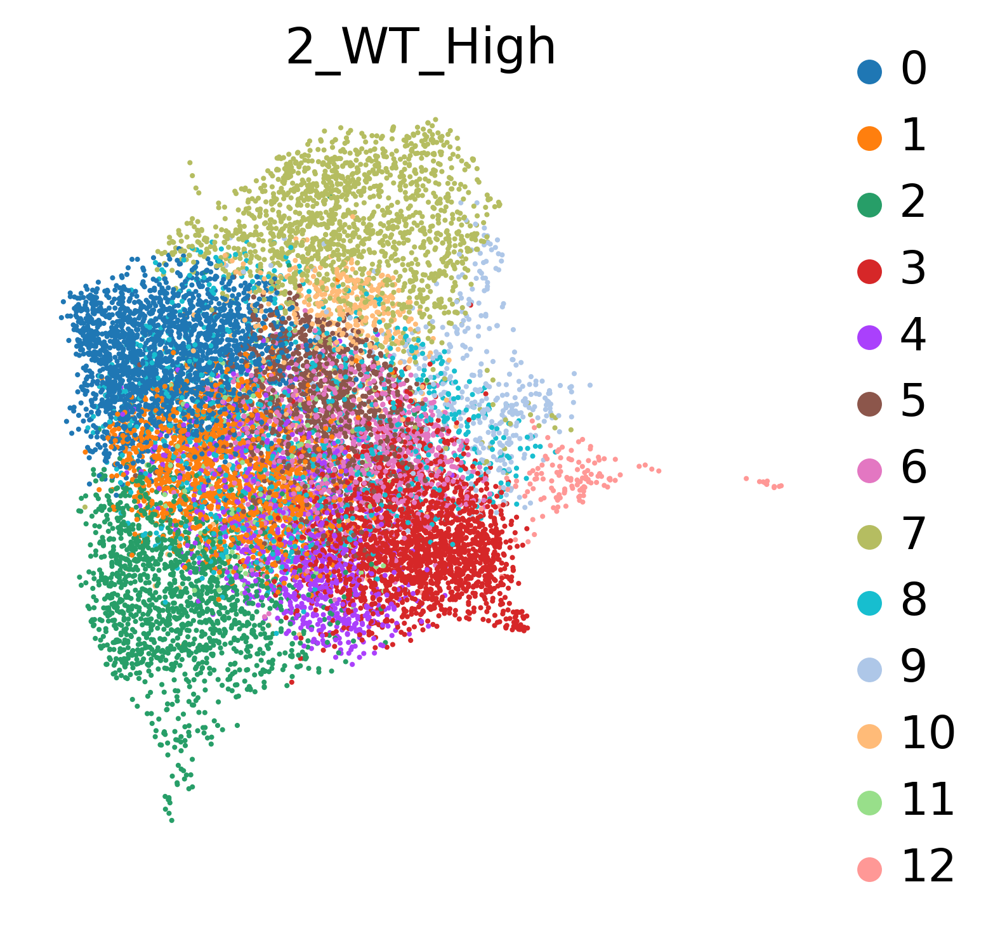

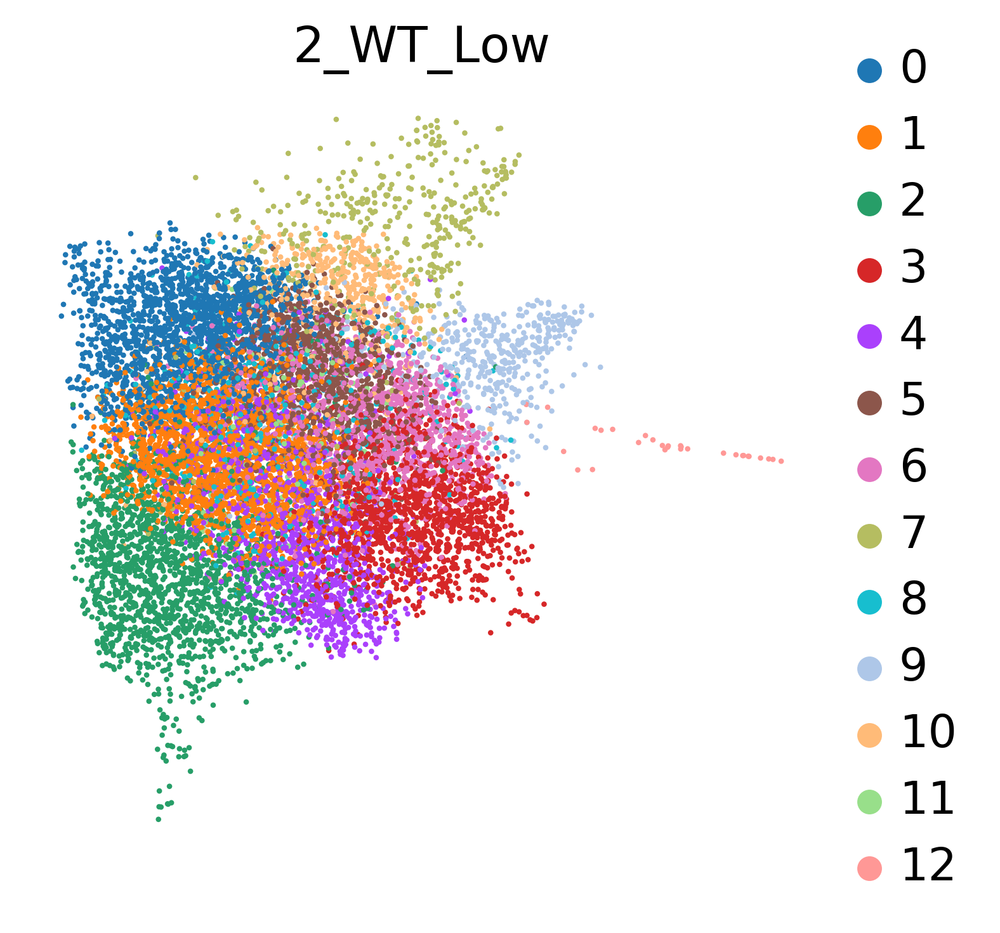

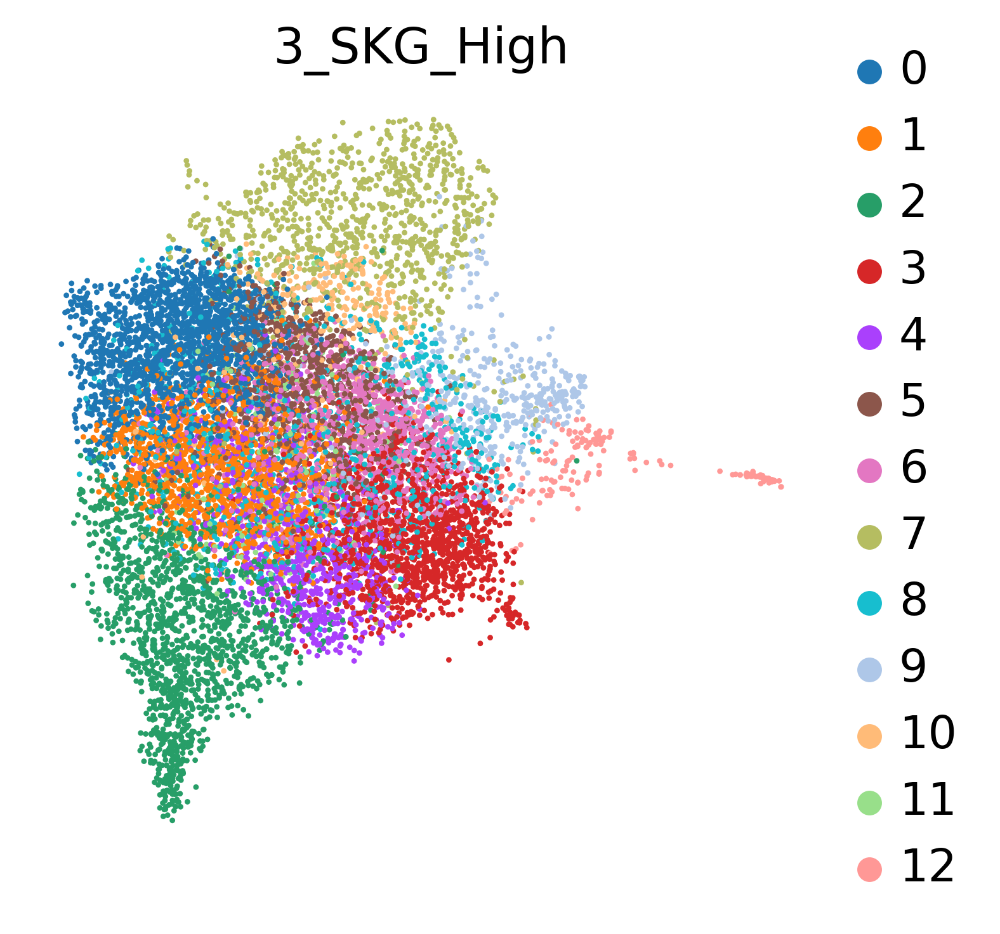

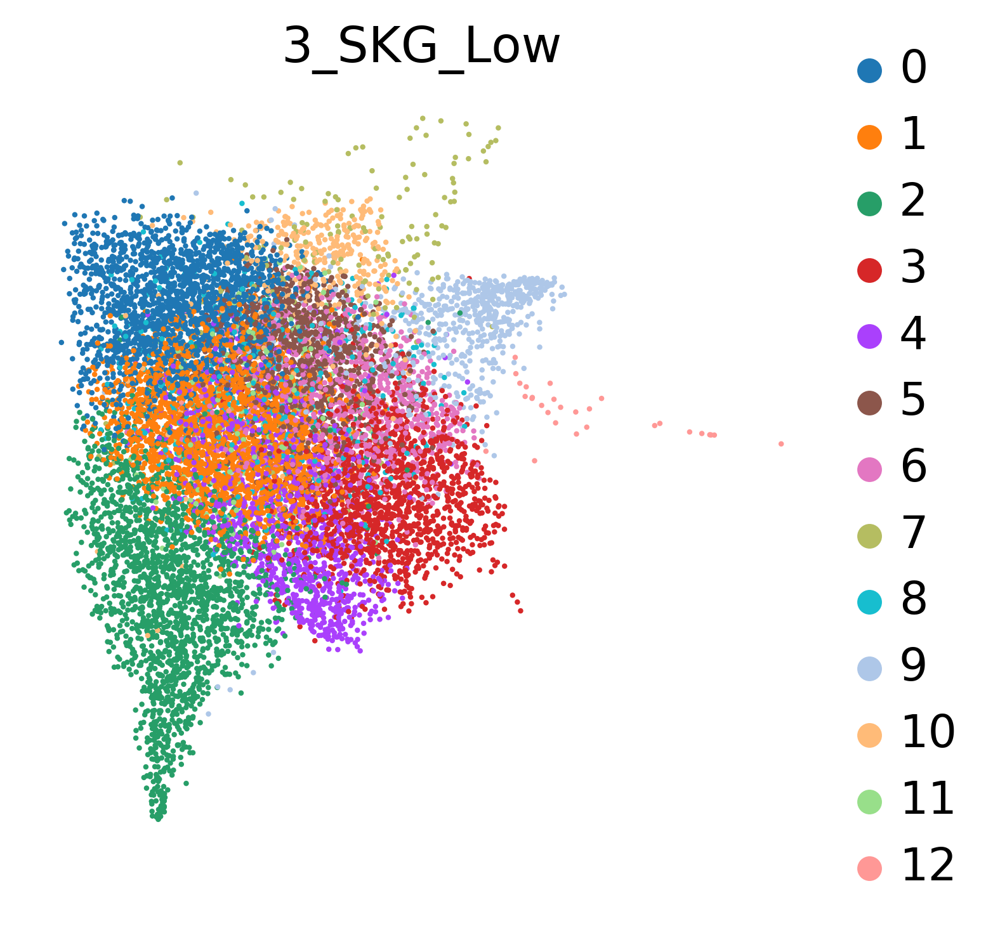

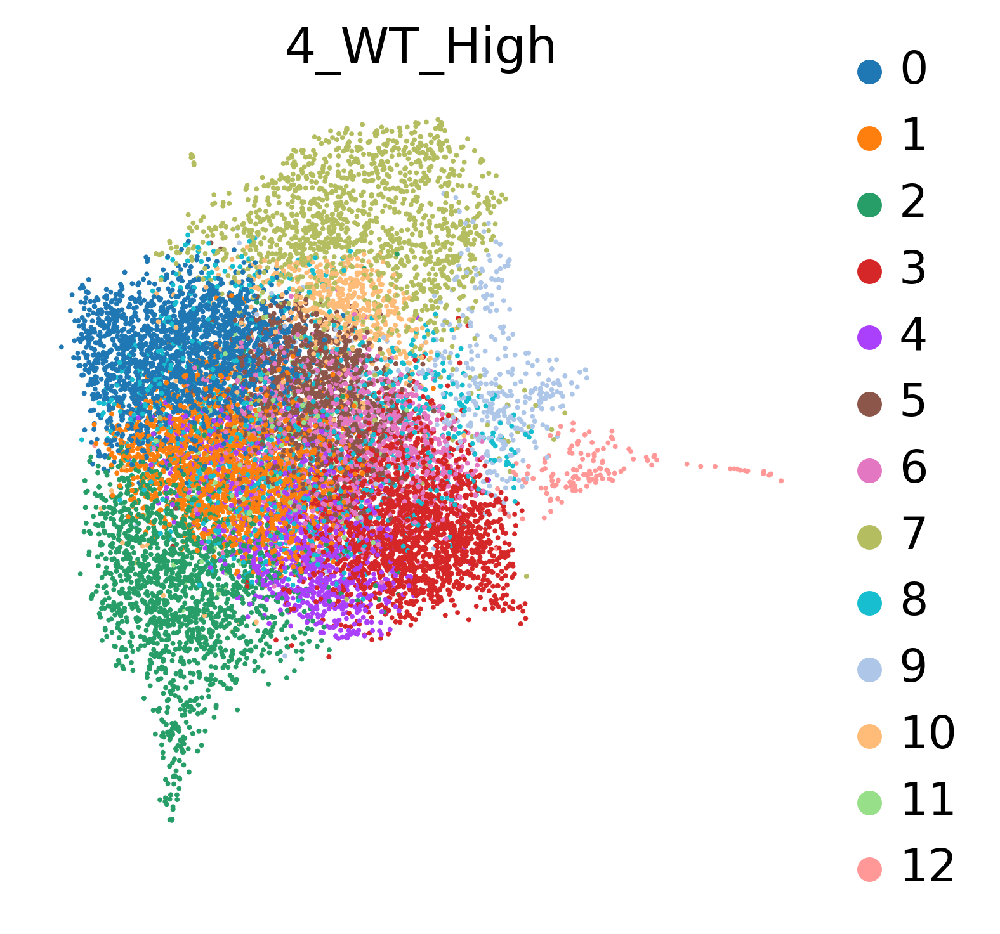

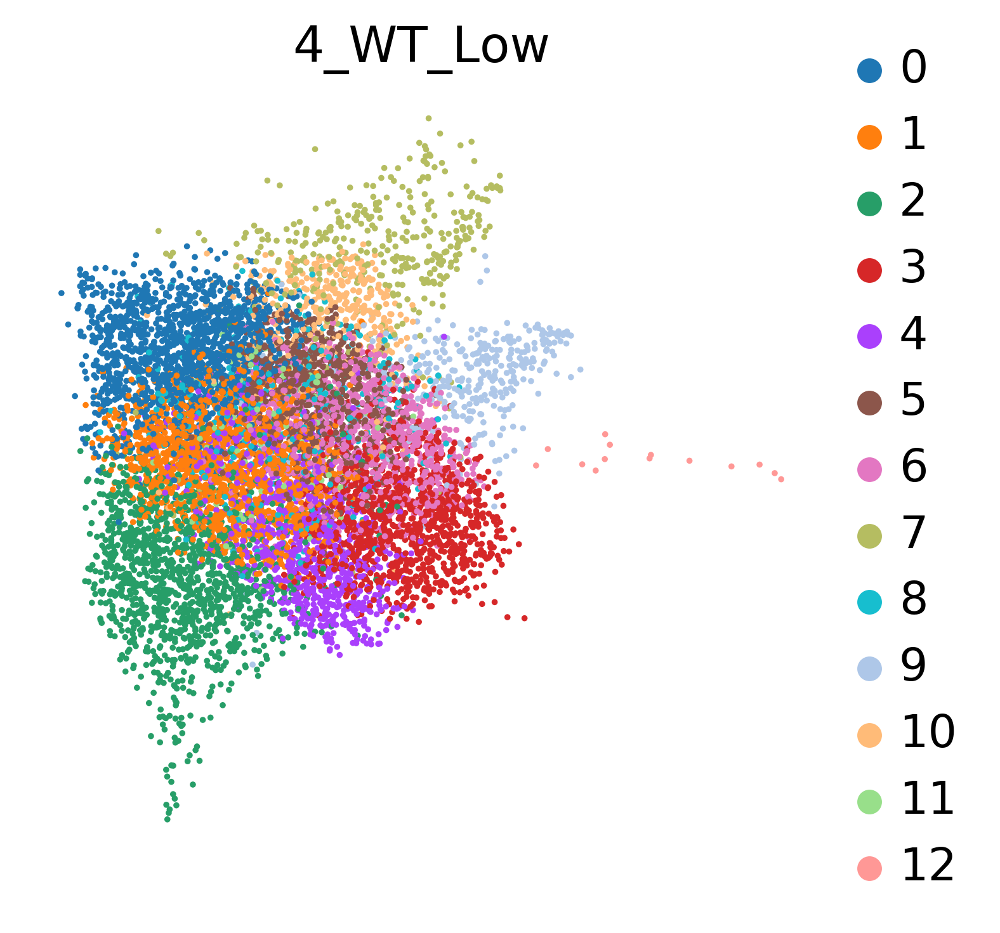

In [21]:
for i in [str(x) for x in list(range(no_wells))]:

    sc.pl.umap(adata[adata.obs['batch'] == i], color=['leiden'], frameon=False, title  = sample_names[int(i)])


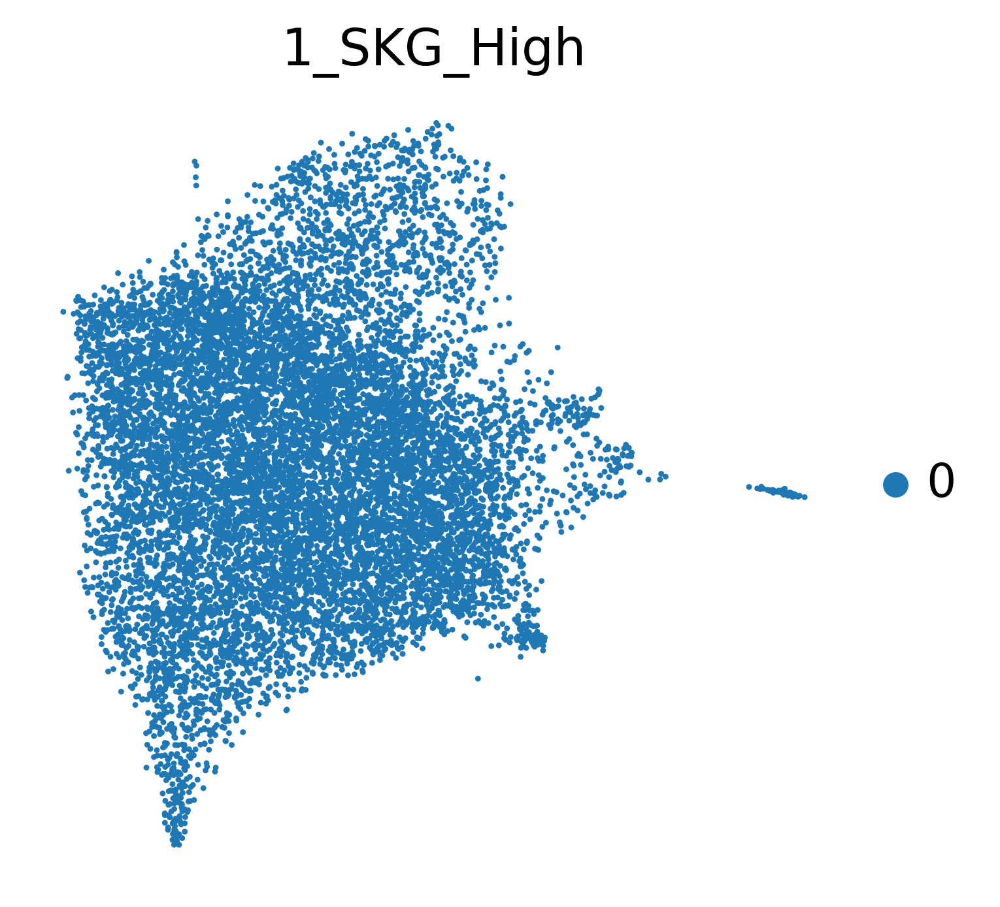

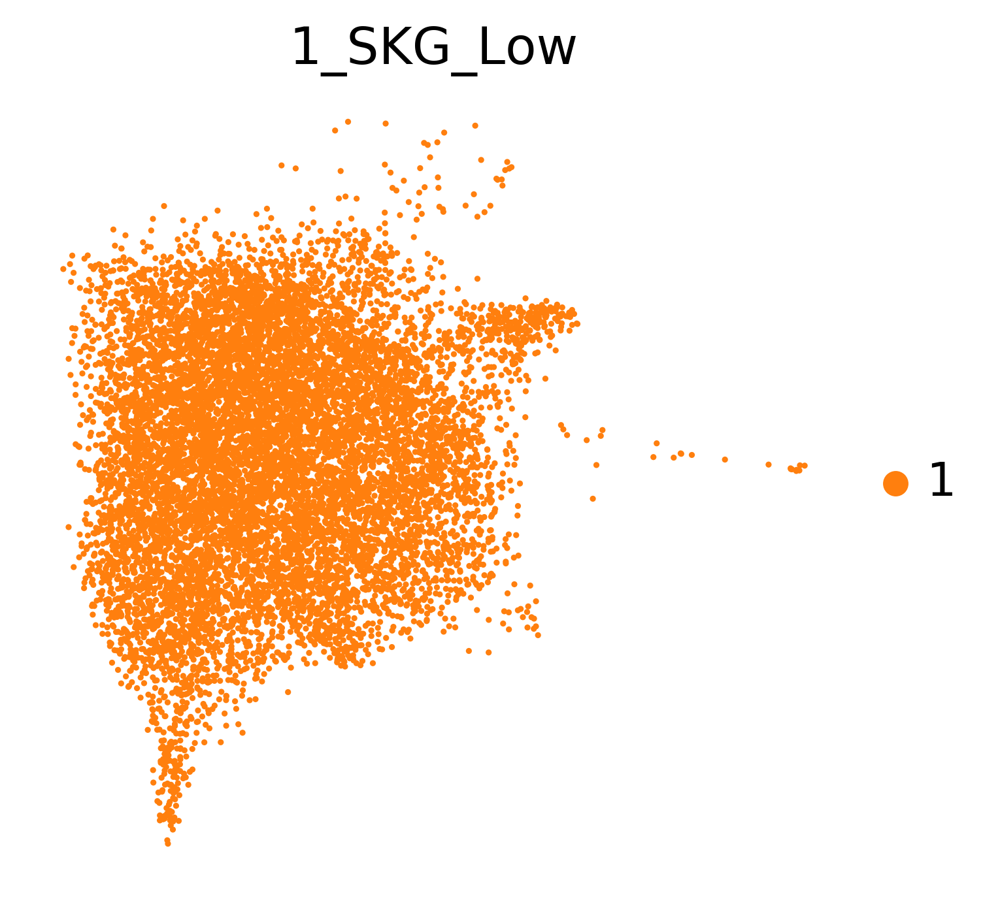

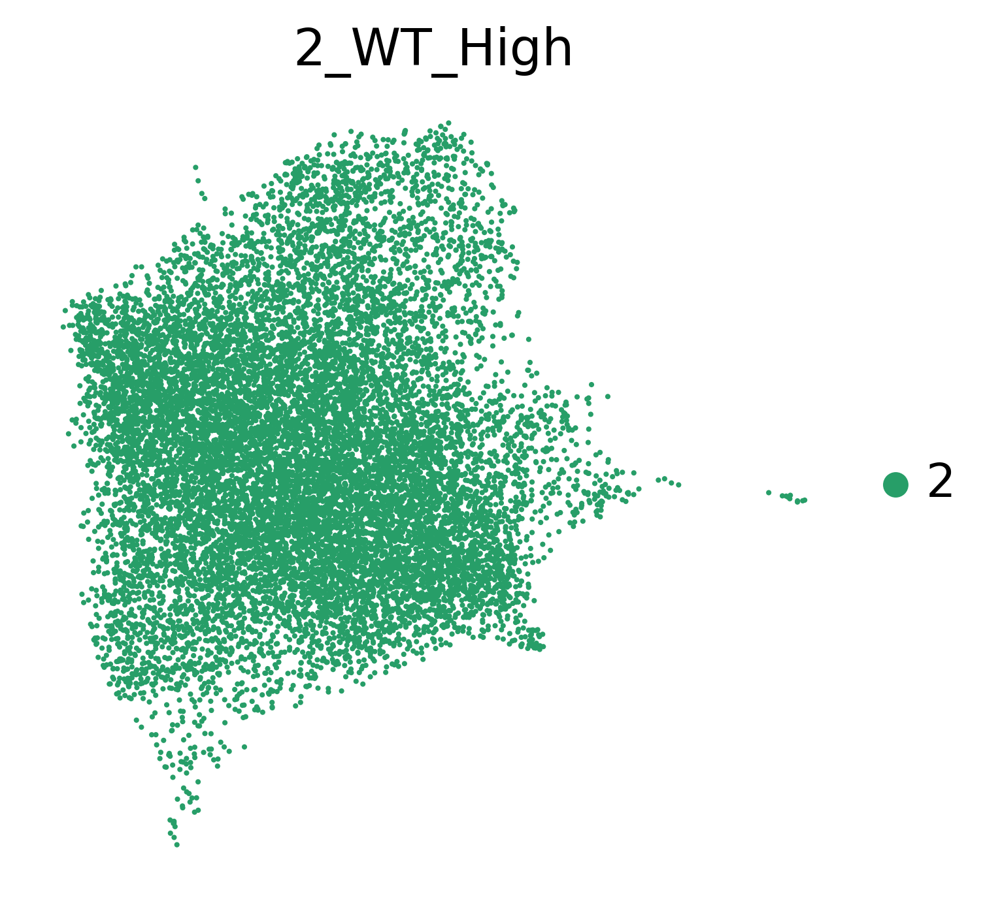

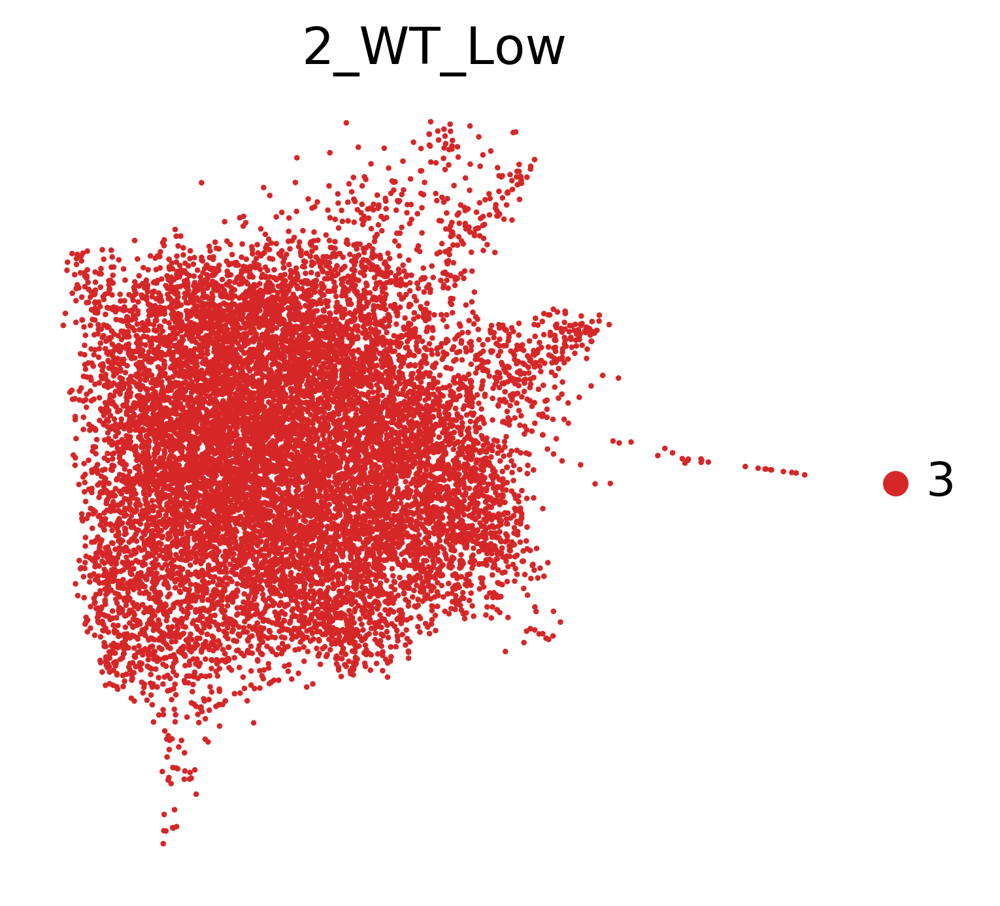

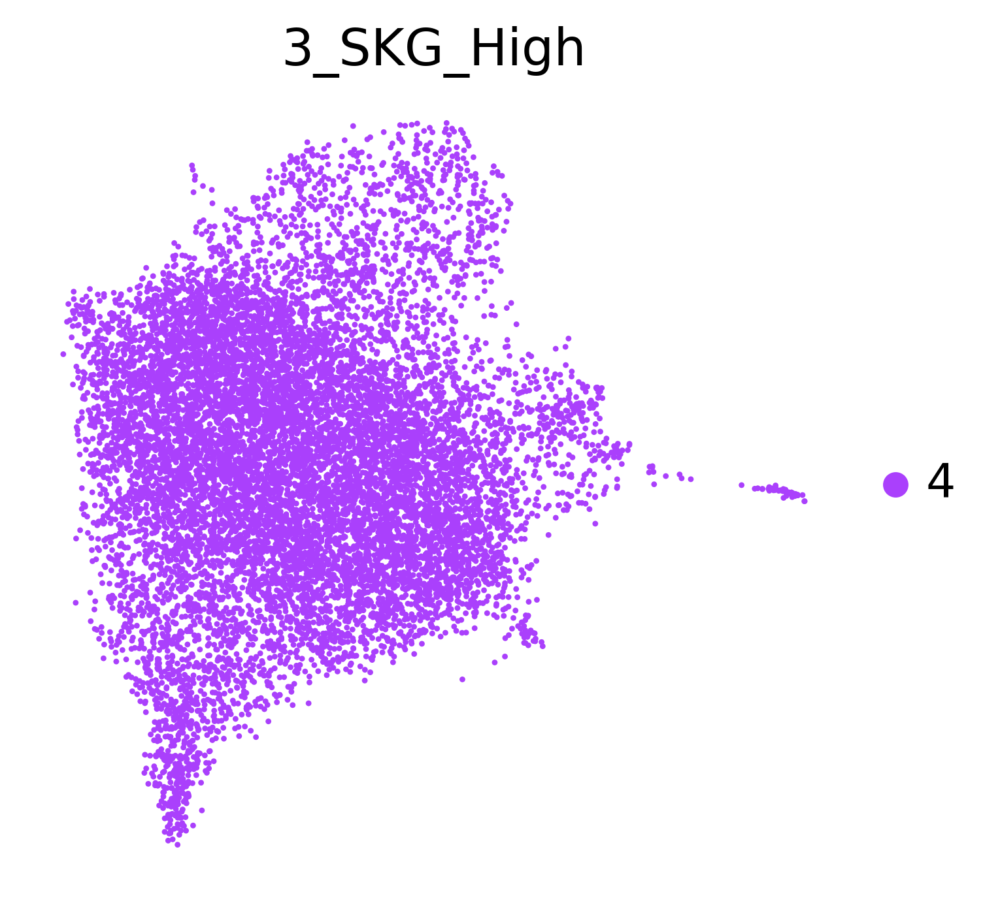

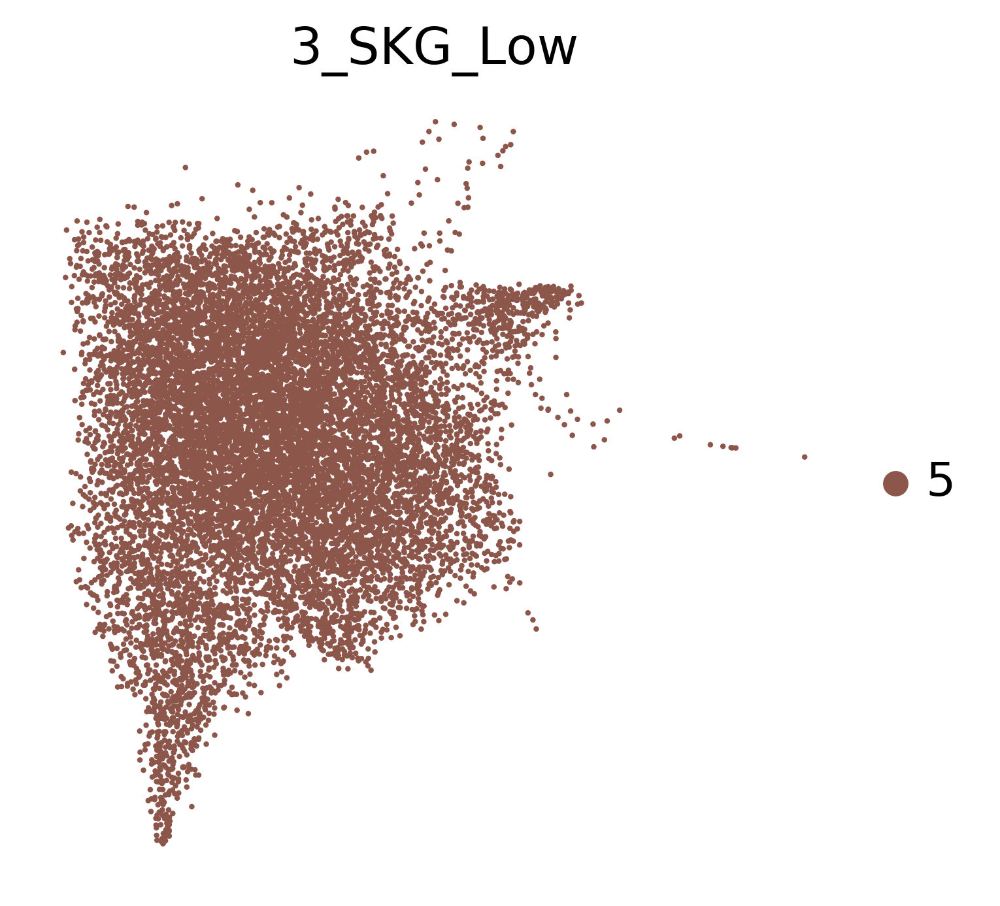

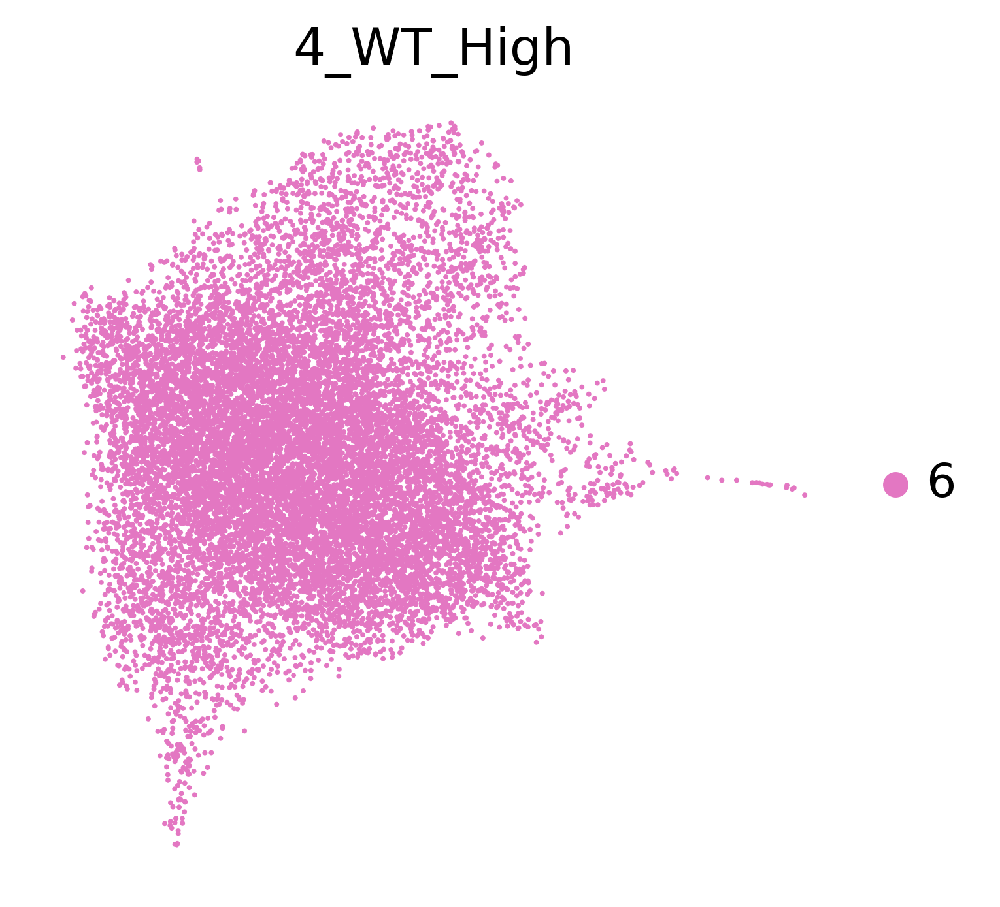

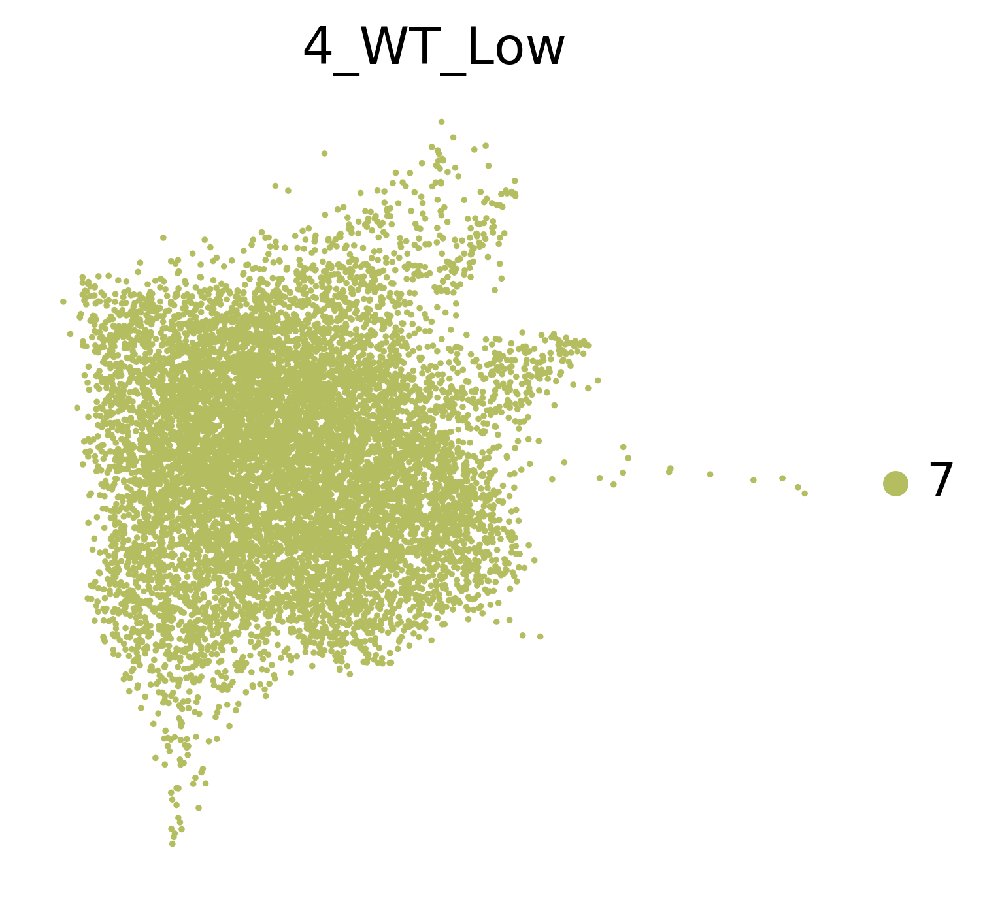

In [22]:

for i in [str(x) for x in list(range(no_wells))]:
    sc.pl.umap(adata[adata.obs['batch'] == i], color=['batch'], frameon=False, title = sample_names[int(i)])


In [23]:
%matplotlib inline
sc.settings.set_figure_params(dpi=300)
plot_genes =  ['Cd3g', 'Cd3d', 'Cd3e', 'Cd4',
                         'Cd8a',
                         'Cd247', 
                         'Cd44',
                         'Il2ra',
              'Cd19','Itga2','Itgam','Itgae',#'Cd14',
               'Fcgr3','Ly6g',]

sc.pl.umap(adata, color=plot_genes, use_raw = True, cmap='bwr', size = 3, vmin = 0, vmax = 3)

/netapp/home/jashouri1/miniconda3/envs/scanpy_v1-4-3/lib/python3.7/site-packages/anndata/core/anndata.py:299: FutureWarning: In anndata v0.7+, arrays contained within an AnnData object will maintain their dimensionality. For example, prior to v0.7 `adata[0, 0].X` returned a scalar and `adata[0, :]` returned a 1d array, post v0.7 they will return two dimensional arrays. If you would like to get a one dimensional array from your AnnData object, consider using the `adata.obs_vector`, `adata.var_vector` methods or accessing the array directly.
  warn_flatten()


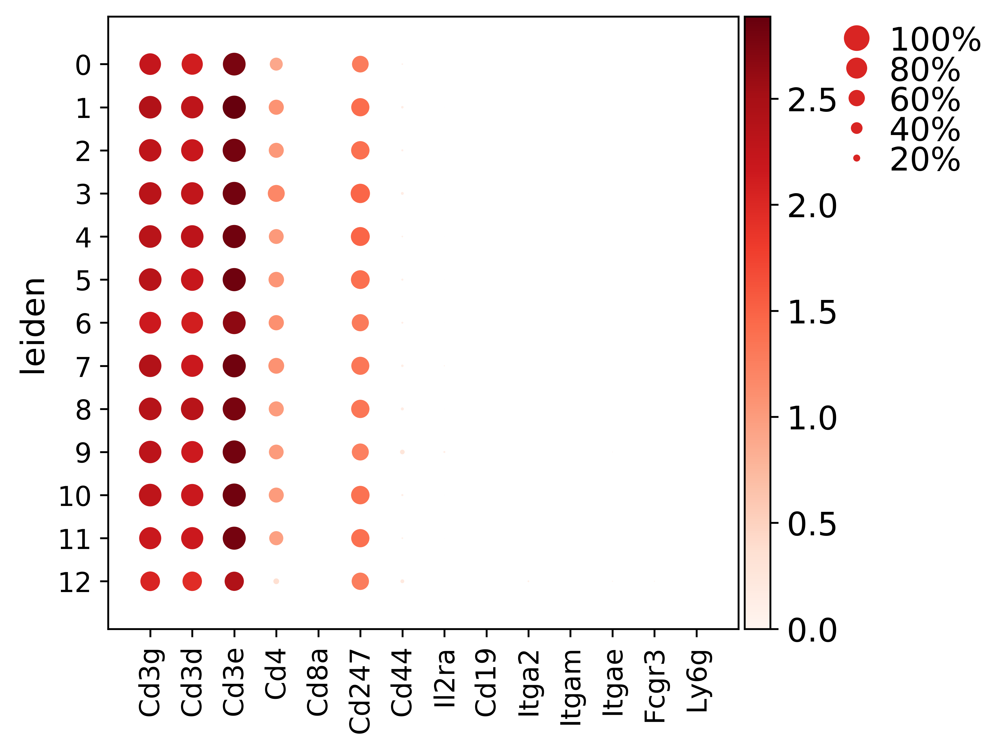

GridSpec(2, 5, height_ratios=[0, 10.5], width_ratios=[4.8999999999999995, 0, 0.2, 0.5, 0.25])

In [24]:
plot_genes =  ['Cd3g', 'Cd3d', 'Cd3e', 'Cd4',
                         'Cd8a',
                         'Cd247', 
                         'Cd44',
                         'Il2ra',
              'Cd19','Itga2','Itgam','Itgae',#'Cd14',
               'Fcgr3','Ly6g',]

sc.pl.dotplot(adata, plot_genes, use_raw = True, groupby = 'leiden')

In [25]:
path = "adata_object/"
adata_file = path + 'adata_only_T_cells.h5ad'
adata.write(adata_file,compression="gzip")